# Camera Calibration
1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image.

Populating the interactive namespace from numpy and matplotlib


/Users/trimchala/miniconda/envs/aind-dog/lib/python3.5/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['f', 'axes']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


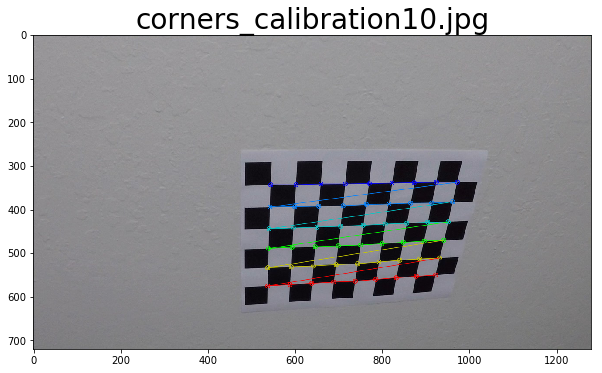

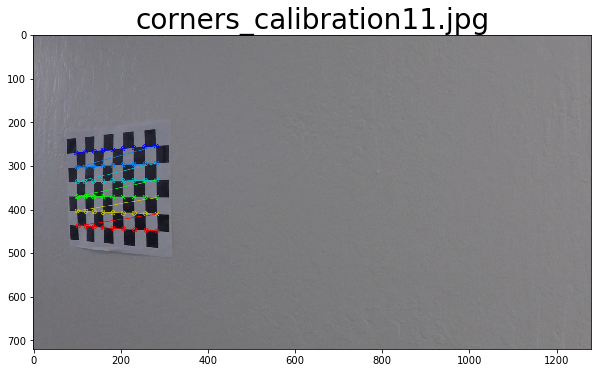

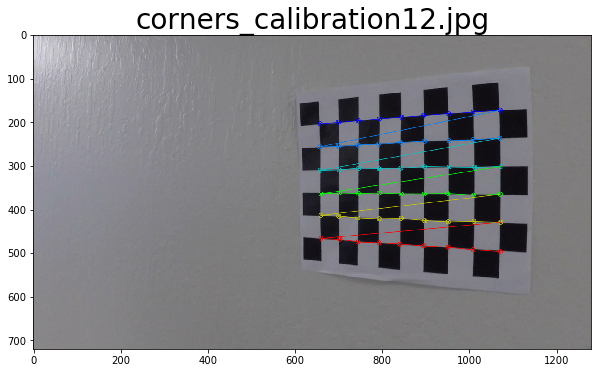

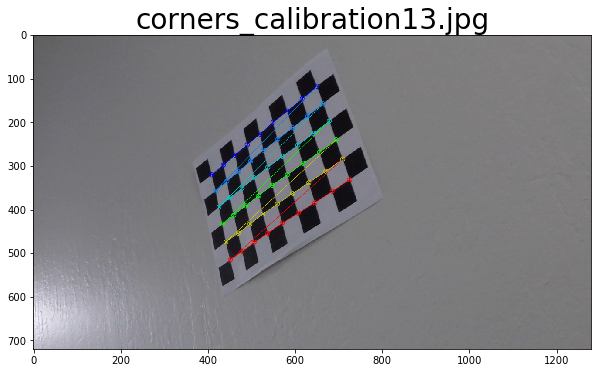

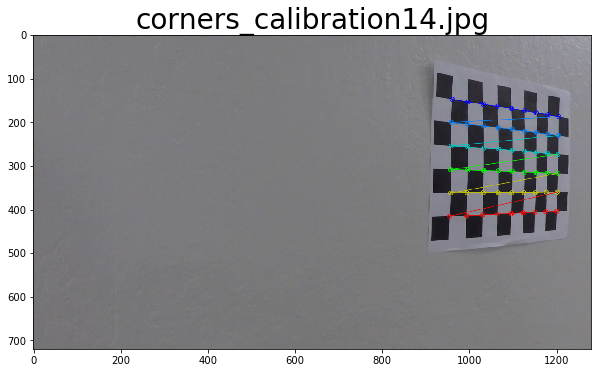

...

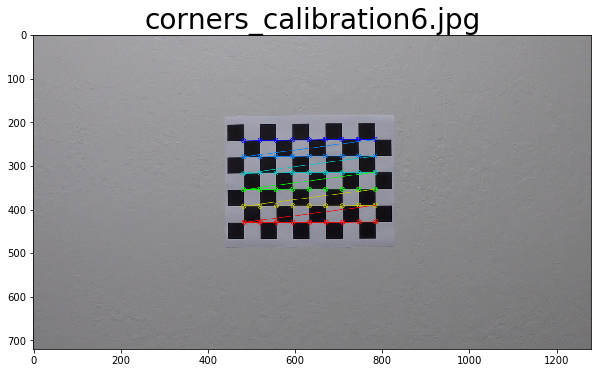

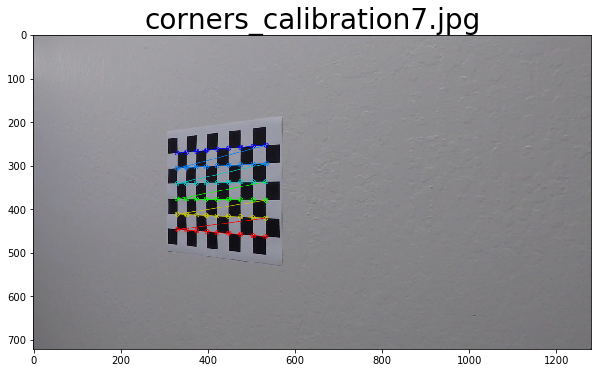

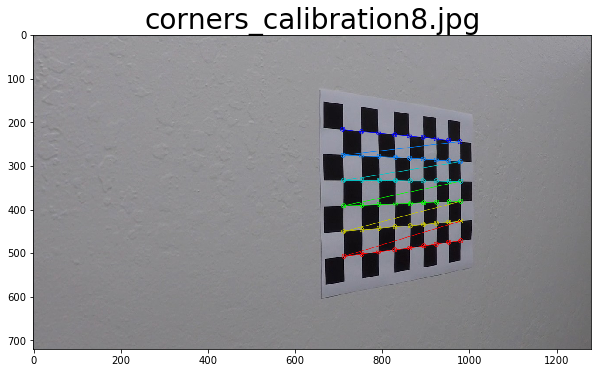

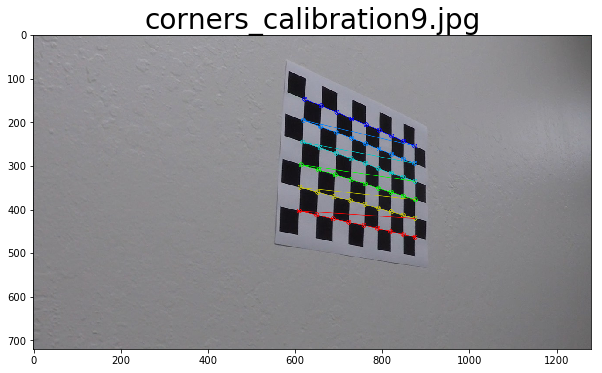

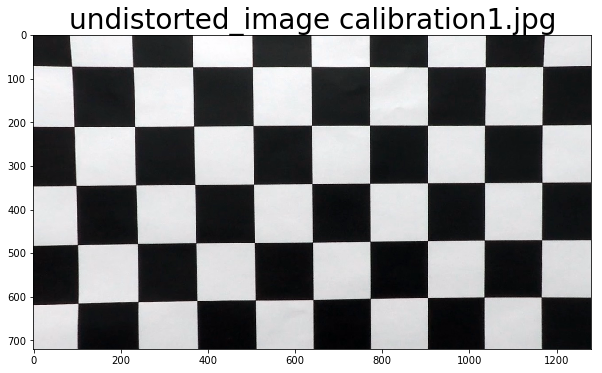

In [3]:
import glob
import matplotlib.image as mpimg
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pickle
import os

% pylab inline

def draw_corners(img, nx, ny, corners, ret, output_name, output_dir="../camera_cal_output/", save_output=True):
    cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(img)
    ax.set_title(output_name, fontsize=28)
    
    if save_output: 
        if not os.path.isdir(output_dir):
            os.makedirs(output_dir)
        cv2.imwrite(os.path.join(output_dir, output_name), img)        

def run_calibrate_camera(
    calibration_image_files, nx=9, ny=6, 
    output_dir="../camera_cal_output/", 
    output_file="camera_cal.p", 
    save_output=True):
    
    objpoints = []
    imgpoints = []

    objp = np.zeros((ny*nx,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)
    
    # Find obj_points from all images
    for img_file in calibration_image_files: 
        img = mpimg.imread(img_file)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        if ret==True: 
            objpoints.append(objp)
            imgpoints.append(corners)
            img_name = img_file.split('/')[-1]
            draw_corners(
                img, nx, ny, corners, ret, 
                output_dir=os.path.join(output_dir, "images"),
                output_name="corners_" + img_name, save_output=save_output
            )
    # Calibrate 
    h, w = gray.shape[::-1]
    reference_img = cv2.imread('../camera_cal/calibration1.jpg')
    img_size = (reference_img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    dst = cv2.undistort(reference_img, mtx, dist, None, mtx)
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(dst)
    ax.set_title('undistorted_image calibration1.jpg', fontsize=28)
    
    if save_output: 
        if not os.path.isdir(output_dir):
            os.makedirs(output_dir)
        with open(os.path.join(output_dir, "camera_cal.p"), "wb") as fo:
            pickle.dump({"mtx":mtx, "dist":dist}, fo)
            
        cv2.imwrite(os.path.join(output_dir, "undistorted_calibration1.jpg"), dst)

    return ret, mtx, dist, rvecs, tvecs
    
nx = 9 # number of x chessboard squares 
ny = 6 # number of y cheseboard squares
calibration_image_files = glob.glob('../camera_cal/calibration*.jpg')
calibration_output_file = "camera_cal.p"
ret, mtx, dist, rvecs, tvecs = run_calibrate_camera(
    calibration_image_files=calibration_image_files, 
    nx=nx, ny=ny, 
    output_dir="../camera_cal_output/", 
    output_file=calibration_output_file
)

In [ ]:
def corners_unwarp(img, nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    # Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        # My choice of 100 pixels is not exact, but close enough for our purpose here
        offset = 100 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])

        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)

    # Return the resulting image and matrix
    return warped, M


# Pipeline (single images)

* [1. Provide an example of a distortion-corrected image.](#undistort)


* [2. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image. Provide an example of a binary image result.](#threshold)


* [3. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.](#perspective)


* [4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?](#fitpoly)


* [5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.](#curvature)


* [6. Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.](#lanearea) 

<a id="undistort">
# Distortion Correction 
</a>

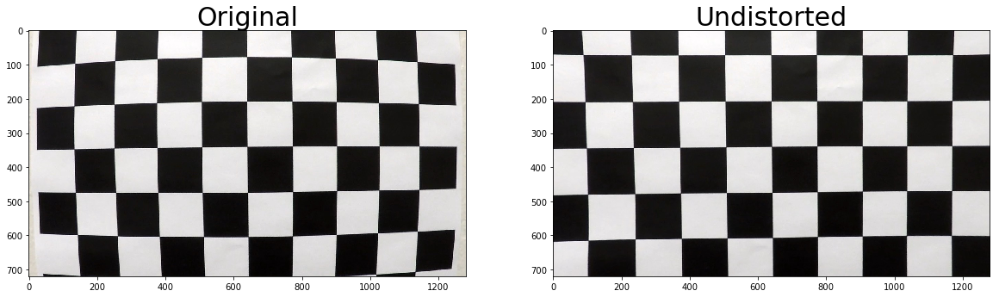

In [8]:
def undistort(img):
    if 'mtx' not in locals() or 'dist' in locals(): 
        with open(os.path.join('../camera_cal_output/camera_cal.p'), "rb") as fi:
            calibration_dict = pickle.load(fi)
            dst = calibration_dict['dist']
            mtx = calibration_dict['mtx']
    return cv2.undistort(img, mtx, dist, None, mtx)

checker_board_image = mpimg.imread('../camera_cal/calibration1.jpg')
undistorted_checker_board = undistort(checker_board_image)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(checker_board_image)
ax1.set_title('Original', fontsize=30)
ax2.imshow(undistorted_checker_board)
ax2.set_title('Undistorted', fontsize=30)


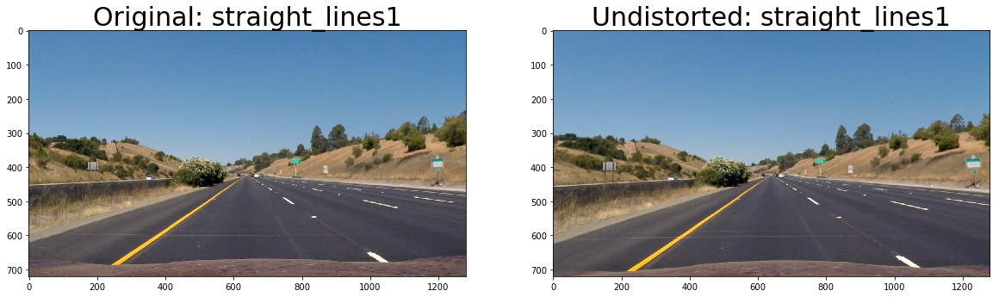

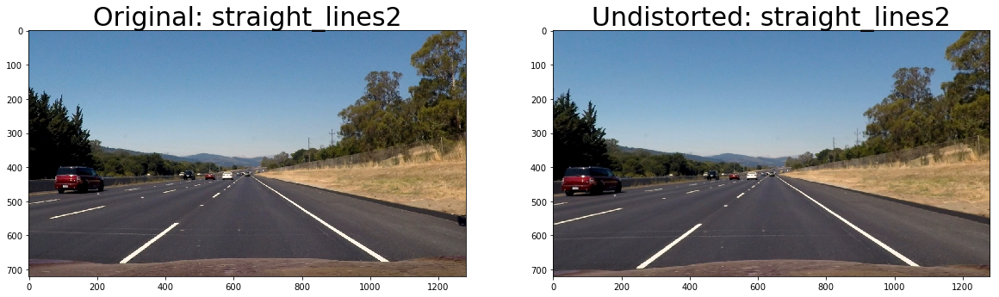

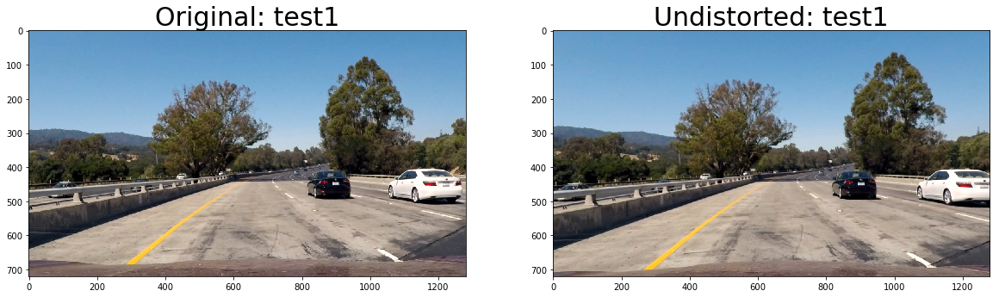

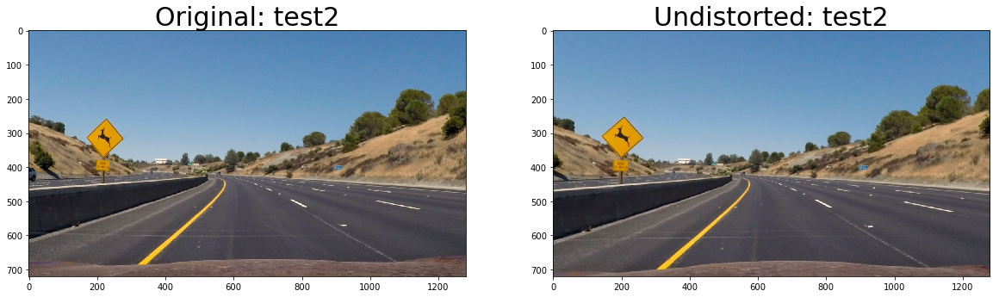

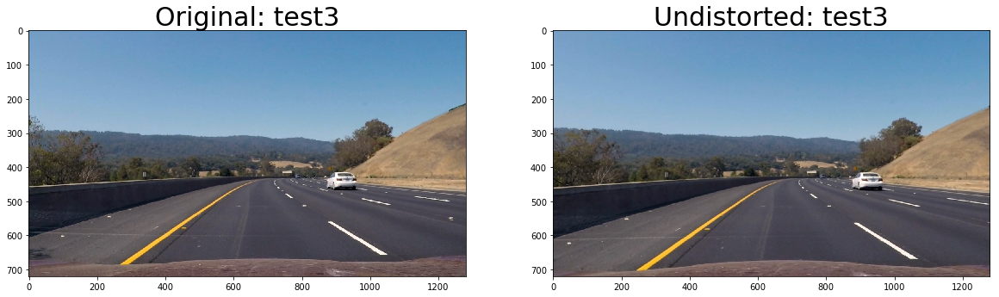

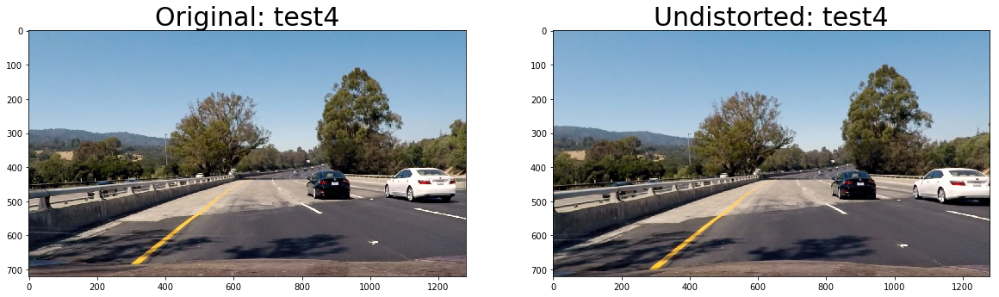

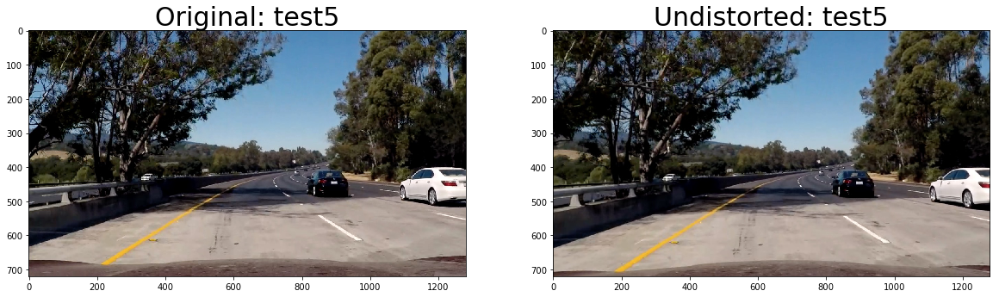

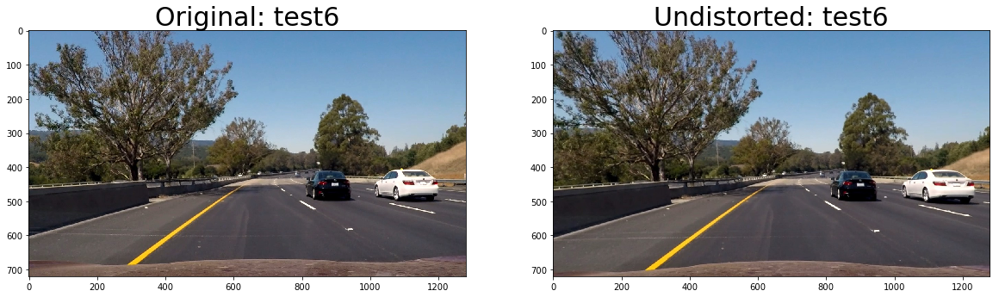

In [18]:
test_image_path = '../test_images/'

road_image_files = glob.glob(os.path.join(test_image_path, '*.jpg'))
road_images = []
image_names = []
undistorted_images = []
for image_file in road_image_files: 
    road_image = mpimg.imread(image_file)
    image_name = image_file.split('/')[-1].split('.')[0]
    road_images.append(road_image)
    image_names.append(image_name)
    undistorted_road_image = undistort(road_image)
    undistorted_images.append(undistorted_road_image)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(road_image)
    ax1.set_title('Original: {}'.format(image_name), fontsize=30)
    ax2.imshow(undistorted_road_image)
    ax2.set_title('Undistorted: {}'.format(image_name), fontsize=30)

<a id="threshold">
# Threshold Binarization
</a>

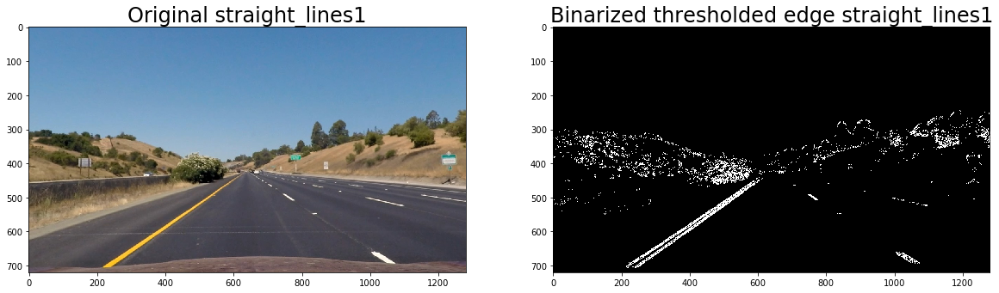

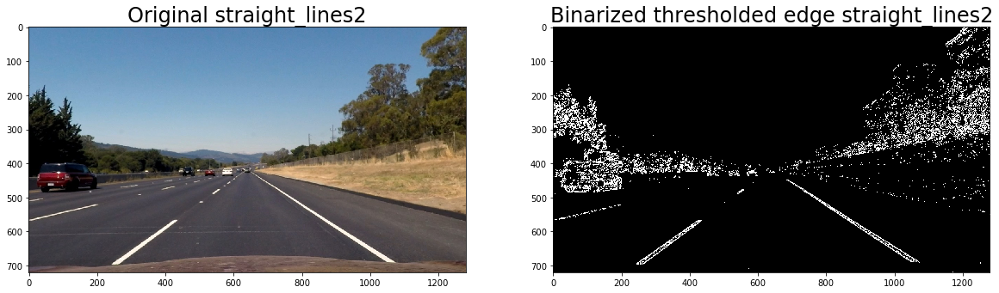

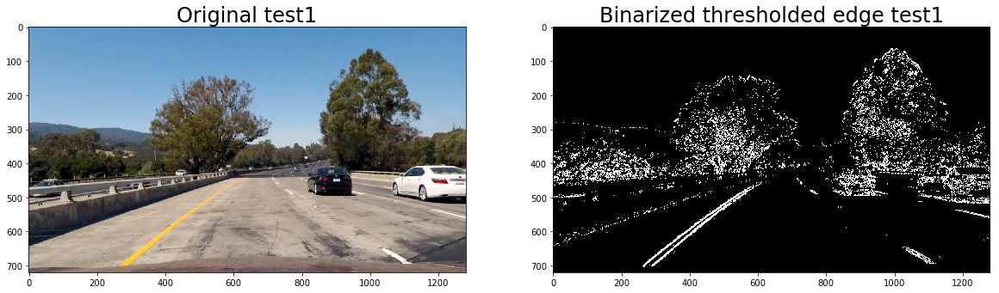

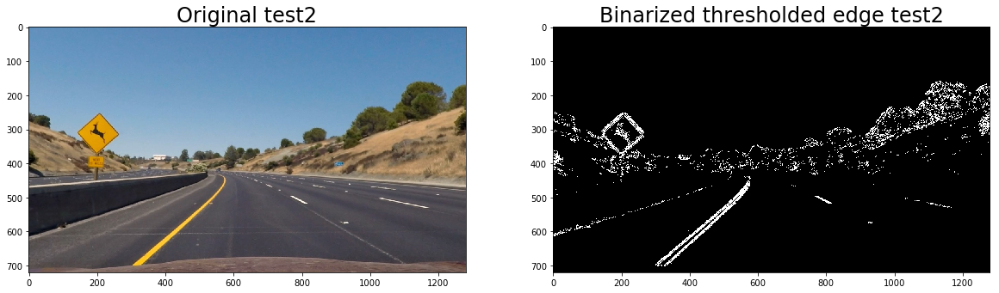

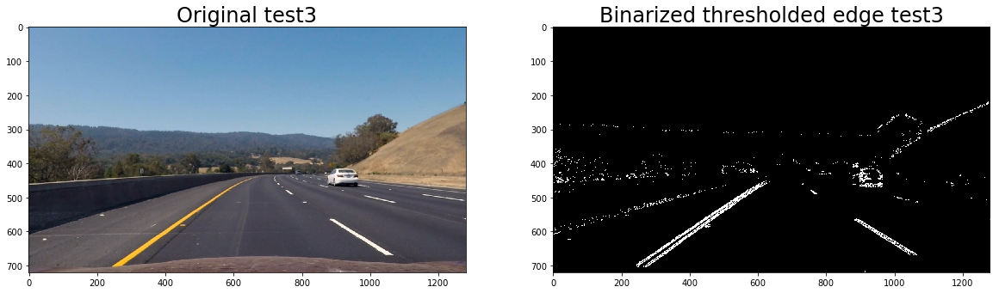

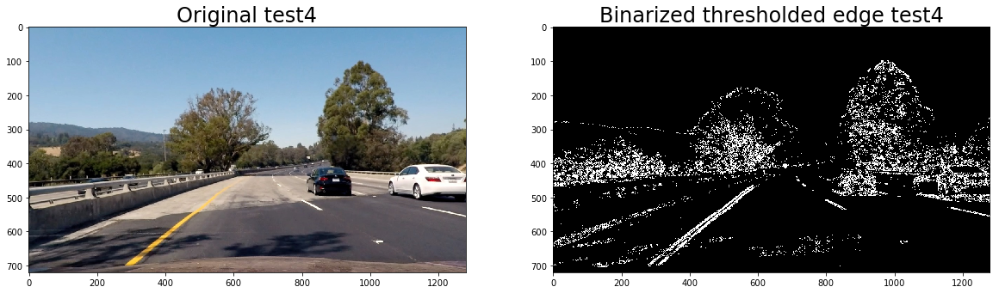

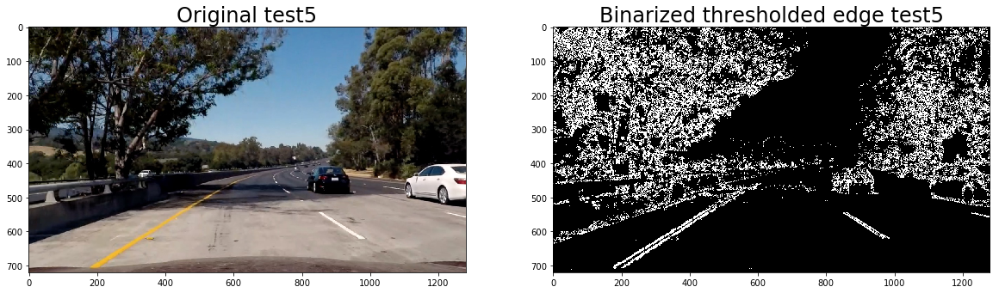

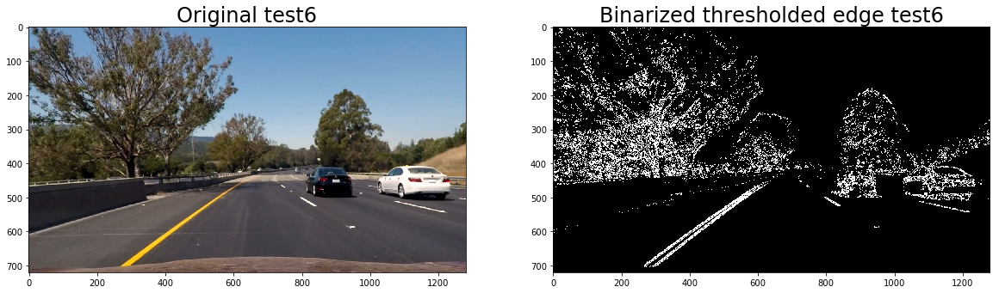

In [60]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2    

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:, :, 2]
    if orient == 'x':
        abs_grad = np.absolute(cv2.Sobel(s_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    else: # assume orient = 'y'
        abs_grad = np.absolute(cv2.Sobel(s_channel, cv2.CV_64F, 0, 1, ksize=sobel_kernel))

    scaled_grad = np.uint8(255*abs_grad/np.max(abs_grad))

    # Apply threshold
    grad_binary = np.zeros_like(scaled_grad)
    grad_binary[(scaled_grad > thresh[0]) & (scaled_grad < thresh[-1])] = 1
    return grad_binary

def dir_threshold(img, sobel_kernel=3, hls_thresh=(0, 255), dir_thresh=(0, np.pi/2)):
    # Calculate gradient direction
    grad_x = abs_sobel_thresh(img, orient='x', sobel_kernel=sobel_kernel, thresh=hls_thresh)
    grad_y = abs_sobel_thresh(img, orient='y', sobel_kernel=sobel_kernel, thresh=hls_thresh)
    graddir = np.arctan2(grad_y, grad_x)
    
    # Apply threshold
    dir_binary = np.zeros_like(graddir)
    dir_binary[(graddir > dir_thresh[0]) & (graddir < dir_thresh[-1])] = 1
    dir_binary = np.dstack((dir_binary,dir_binary,dir_binary)).astype(float32) 
    return dir_binary

undistorted_binarized_images = []
for image_name, image in zip(image_names, undistorted_images): 
    binarized = dir_threshold(
        image, 
        hls_thresh=(10, 255), 
        dir_thresh=(0.25*np.pi/2, 0.55*np.pi/2)
    )
    undistorted_binarized_images.append(binarized)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Original {}'.format(image_name), fontsize=24)
    ax2.imshow(binarized, cmap='gray')
    ax2.set_title('Binarized thresholded edge {}'.format(image_name), fontsize=24)


<a id="perspective">
# Perspective Transform
</a>

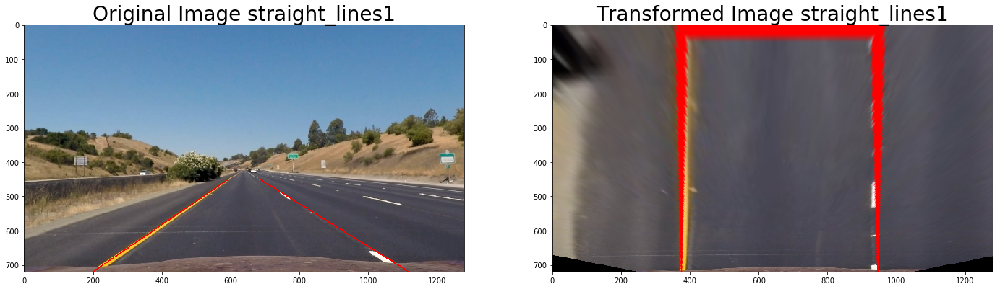

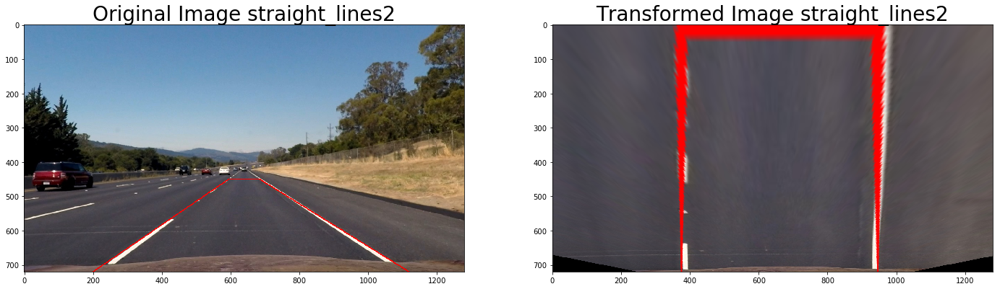

In [26]:
def warp_transform(img, source_points, target_points, inverse=False):
    new_top_left=np.array([source_points[0,0],0])
    new_top_right=np.array([source_points[3,0],0])
    offset=[175,0]
    img_size = (img.shape[1], img.shape[0])
    src = source_points.copy()
    
    dst = np.float32([
        source_points[0]+offset,
        new_top_left+offset,
        new_top_right-offset ,
        source_points[3]-offset]
    )    
    
    if not inverse:
        M = cv2.getPerspectiveTransform(src, dst)
    else:
        M = cv2.getPerspectiveTransform(tgt,src)
    warped = cv2.warpPerspective(img, M, img_size , flags=cv2.INTER_LINEAR)    
    return warped, M, dst

left_x = 200
right_x = 1120
margin = 0
refh, refw = image.shape[:2]
source_points = np.float32([
    (left_x, refh-margin),
    (595,450),
    (685,450),
    (right_x,refh-margin)]
)

# Define target
target_points = np.float32([
    (left_x, refh-margin), 
    (left_x, margin), 
    (right_x, margin), 
    (right_x, refh-margin)
])


# Define source 
lw = 2
fontsize=28
for reference_image_file in glob.glob('../test_images/straight*.jpg'):
    reference_image = mpimg.imread(reference_image_file)
    reference_image_name = reference_image_file.split('/')[-1].split('.')[0]
    reference_image = cv2.undistort(reference_image, mtx, dist, None, mtx)
    
    # Source Image
    f, (a1, a2) = plt.subplots(1, 2, figsize=(24, 12))
    cv2.line(reference_image, tuple(source_points[0]), tuple(source_points[1]), color=[255,0,0], thickness=lw)
    cv2.line(reference_image, tuple(source_points[1]), tuple(source_points[2]), color=[255,0,0], thickness=lw)
    cv2.line(reference_image, tuple(source_points[2]), tuple(source_points[3]), color=[255,0,0], thickness=lw)
    cv2.line(reference_image, tuple(source_points[3]), tuple(source_points[0]), color=[255,0,0], thickness=lw)
    a1.imshow(reference_image)
    a1.set_title("Original Image {}".format(reference_image_name), fontsize=fontsize)

    transformed_image, transform_matrix, dst = warp_transform(reference_image, source_points, target_points, inverse=False)
    cv2.line(transformed_image, tuple(dst[0]), tuple(dst[1]), color=[255,0,0], thickness=lw)
    cv2.line(transformed_image, tuple(dst[1]), tuple(dst[2]), color=[255,0,0], thickness=lw)
    cv2.line(transformed_image, tuple(dst[2]), tuple(dst[3]), color=[255,0,0], thickness=lw)
    cv2.line(transformed_image, tuple(dst[3]), tuple(dst[0]), color=[255,0,0], thickness=lw)
    a2.imshow(transformed_image)
    a2.set_title("Transformed Image {}".format(reference_image_name), fontsize=fontsize)

In [79]:
# Define pipeline up to this point: 

def warp_pipeline(img):
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    edge_thresholded = dir_threshold(undistorted, hls_thresh=(5, 255), dir_thresh=(0.25*np.pi/2, 0.55*np.pi/2))
    transformed_image, transform_matrix, dst = warp_transform(edge_thresholded, source_points=source_points, target_points=target_points)
    
    return transformed_image


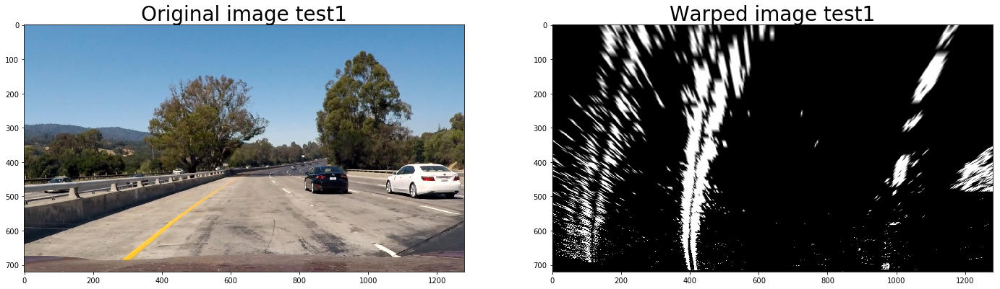

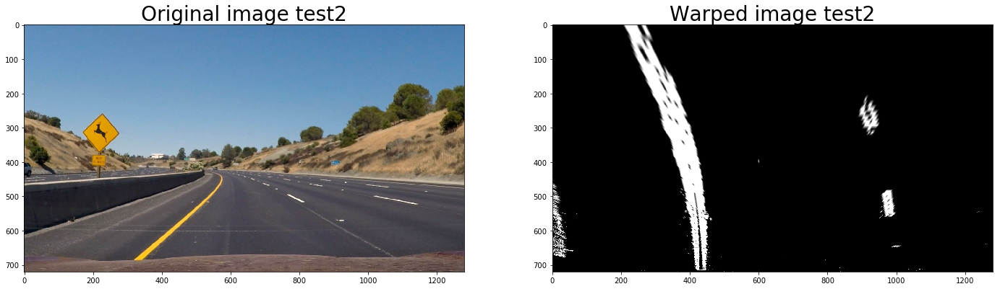

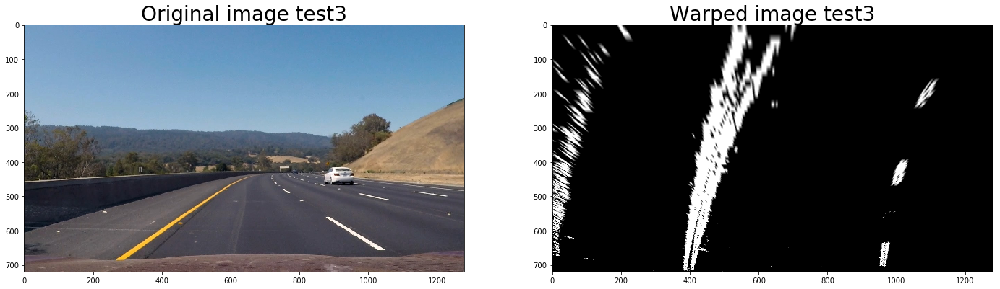

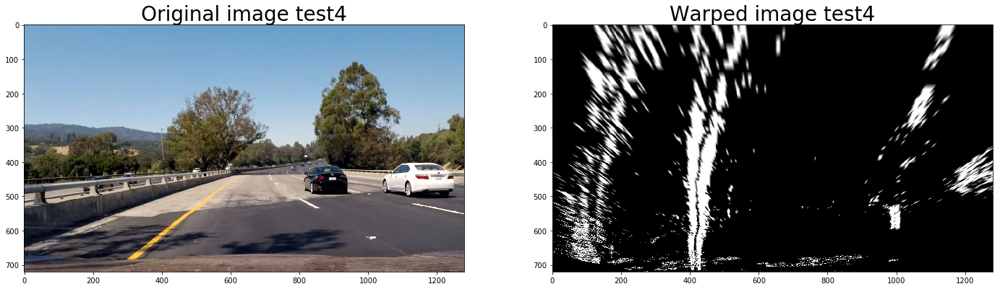

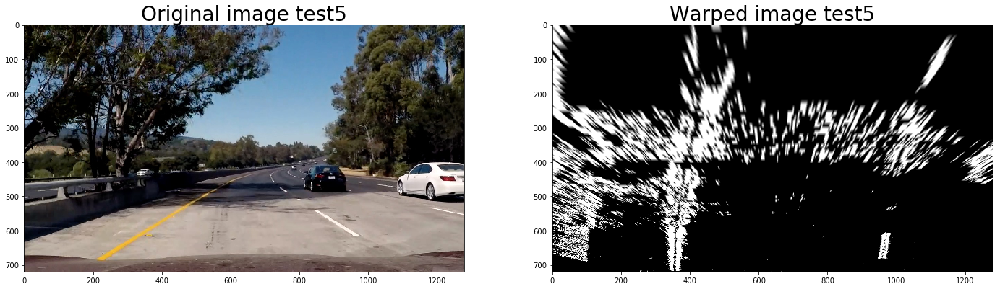

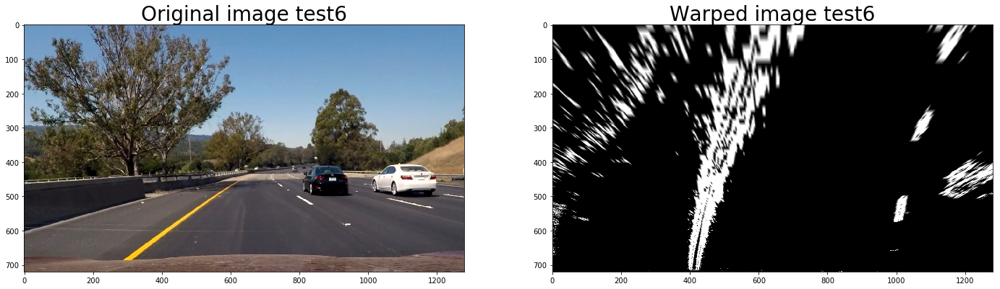

In [80]:
# Test on Test image
warped_test_images = []
test_image_names = []
test_images = []
test_image_files = glob.glob('../test_images/test*.jpg')
for test_image_file in test_image_files:
    test_image_name = test_image_file.split('/')[-1].split('.')[0]
    test_image_names.append(test_image_name)
    test_image = mpimg.imread(test_image_file)
    test_images.append(test_image)
    warped = warp_pipeline(test_image)
    warped_test_images.append(warped)
    f, (a1, a2) = plt.subplots(1, 2, figsize=(24, 12))
    a1.imshow(test_image)
    a1.set_title('Original image {}'.format(test_image_name), fontsize=28)
    a2.imshow(warped, cmap='gray')
    a2.set_title('Warped image {}'.format(test_image_name), fontsize=28)

<a id="fitpoly">
# Polynomial fit
</a>

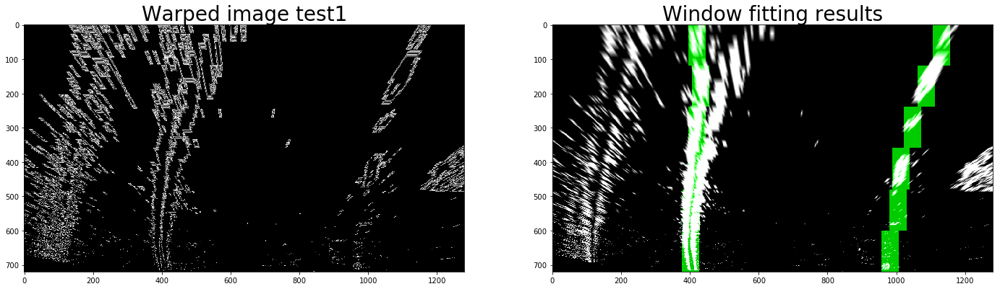

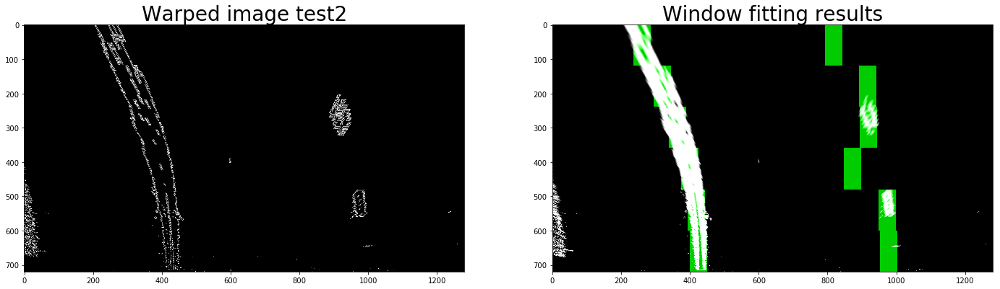

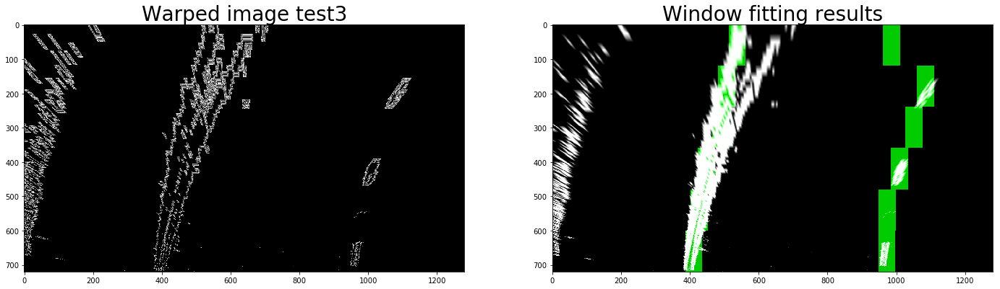

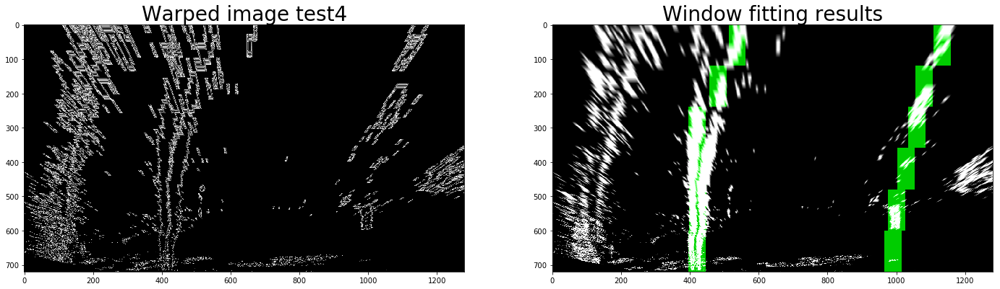

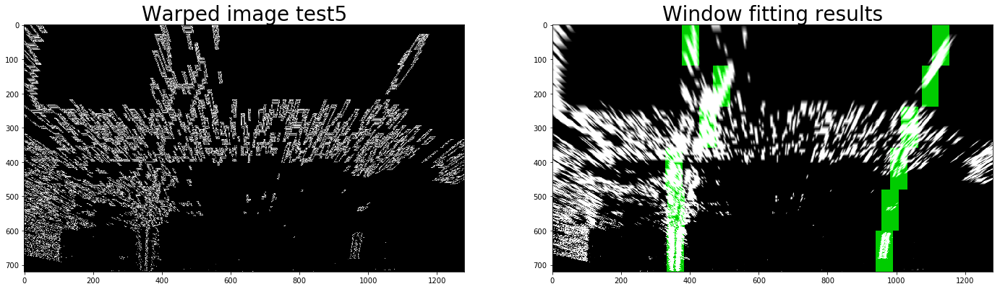

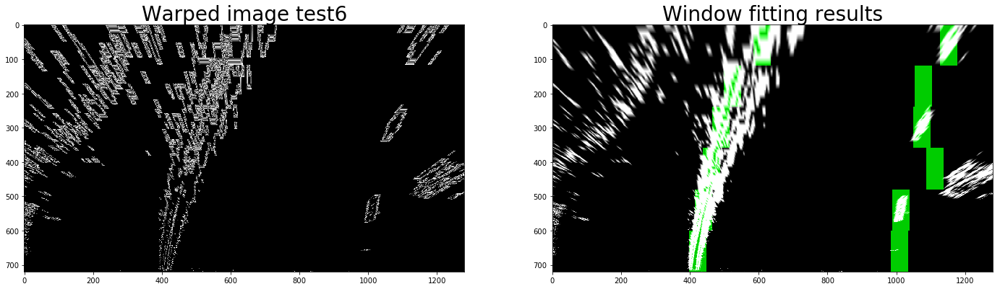

In [114]:
def window_mask(img, window_width, window_height, center, level):
    output = np.zeros_like(img)
    top = int(img.shape[0]-(level+1)*window_height)
    bottom = int(img.shape[0]-(level)*window_height)
    left = max(0,int(center-window_width/2))
    right = min(int(center+window_width/2),img.shape[1])
    output[top:bottom, left:right] = 1
    return output

def trace_window_centroids(img, window_width, window_height, margin):
    
    window_centroids = []
    window = np.ones(window_width)
    offset = window_width/2
    
    # Find seed center positions for level0 left and right windows
    vfrac = 0.75
    hfrac = 0.5
    vidx = int(vfrac*img.shape[0])
    hidx = int(hfrac*img.shape[1])
    
    # Find peaks
    l_sum = np.sum(img[vidx:, :hidx], axis=0)
    l_center = np.argmax(np.convolve(window, l_sum)) - window_width/2 
    r_sum = np.sum(img[vidx:, hidx:], axis=0)
    r_center = hidx + np.argmax(np.convolve(window, r_sum)) - window_width/2
    
    # Add seed centroids to the list of window centroids
    window_centroids.append((l_center, r_center))
    
    num_windows = int(img.shape[0]/window_height)

    # Iterate window finding logic using level 0 centroid as seed
    
    for level in range(1, num_windows): 
        layer_top = int(img.shape[0]-(level+1)*window_height)
        layer_bottom = int(img.shape[0]-(level)*window_height)
        layer_summed = np.sum(img[layer_top:layer_bottom, :], axis=0)
        layer_convolved = np.convolve(window, layer_summed)
        
        # Contraints for Left Lane window position
        # horizontal starts at the left edge of image or offset from previous level center
        
        l_min_index = int(max(l_center+offset-margin, 0))
        # horizontal ends at the right edge of image or offset from previous level center
        l_max_index = int(min(l_center+offset+margin, img.shape[1]))
        # Current level window centroid
        l_center = np.argmax(layer_convolved[l_min_index:l_max_index]) + l_min_index - offset
        
        # Same logic for Right Lane window position
        r_min_index = int(max(r_center+offset-margin, 0))
        r_max_index = int(min(r_center+offset+margin, img.shape[1]))
        r_center = np.argmax(layer_convolved[r_min_index:r_max_index]) + r_min_index - offset
        
        window_centroids.append((l_center, r_center))
    
    return window_centroids

def get_lane_points(warped, window_width=50, window_height=120, margin=100, show_result=True):
    
    if len(warped.shape) == 3: 
        warped = cv2.cvtColor(warped, cv2.COLOR_RGB2GRAY)
        
    window_centroids = trace_window_centroids(
        warped, 
        window_width, 
        window_height, 
        margin
    )

    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    for level in range(len(window_centroids)): 
        l_mask = window_mask(
            img=warped, 
            window_width=window_width, 
            window_height=window_height,
            center=window_centroids[level][0],
            level=level
        )

        r_mask = window_mask(
            img=warped, 
            window_width=window_width, 
            window_height=window_height,
            center=window_centroids[level][1],
            level=level
        )
        
        l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255
        
        windowed_warped = np.zeros_like(warped)
        windowed_warped[(l_points == 255) | ((l_mask == 1) ) ]
        
    return l_points, r_points

def display_window_tracing(warped, l_points, r_points, image_name):    
    # Draw the results
    if len(warped.shape) == 3: 
        warped = cv2.cvtColor(warped, cv2.COLOR_RGB2GRAY)
    template = np.array(r_points+l_points, np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage = np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels

    output = cv2.addWeighted(warpage.astype(np.uint8), 1, template, 0.8, 0.0) # overlay the orignal road image with window results    
    #Display the final results
    f, (a1, a2) = plt.subplots(1, 2, figsize=(24, 12))
    a1.imshow(warpage)
    a1.set_title('Warped image {}'.format(image_name), fontsize=28)
    a2.imshow(output)
    a2.set_title('Window fitting results'.format(image_name), fontsize=28)
    plt.show()
    
window_width = 80
window_height = 120
margin = 50

for image_name, warped in zip(test_image_names, warped_test_images): 
    l_points, r_points = get_lane_points(warped)
    l_points_indices = np.where(l_points == 255)
    r_points_indices = np.where(r_points == 255)
    display_window_tracing(warped, l_points, r_points, image_name)


In [115]:
# Define pipeline up to this point: 
window_width = 80
window_height = 120
margin = 50

def window_pipeline(img):
    warped = warp_pipeline(img)
    l_points, r_points = get_lane_points(
        warped, 
        window_width=window_width, 
        window_height=window_height, 
        margin=margin
    )
    l_points_indices = np.where(l_points == 255)
    r_points_indices = np.where(r_points == 255)
    display_window_tracing(warped, l_points, r_points, image_name)
    
    return l_points, r_points

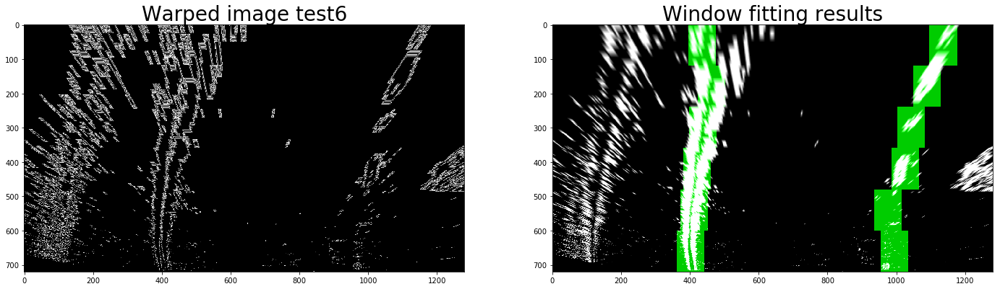

In [116]:
l_points, r_points = window_pipeline(road_images[2])

<a id="curvature">
# Radius of Curvature
</a>

In [160]:
# Define a class to receive the characteristics of each line detection
class Line():
    ym_per_pix = 30/270
    xm_per_pic = 3.7/700

    def __init__(self, allx=None, ally=None, unit='meter'):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = allx  
        #y values for detected line pixels
        self.ally = ally
        self.unit = unit
        
    def fit_lane_line(self, unit='meter'):
        if self.allx is not None and self.ally is not None: 
            self.detected = True
            if not self.unit =='meter':
                self.current_fit = np.polyfit(self.ally, self.allx, 2)
            else: 
                x = self.allx*xm_per_pix
                y = self.ally*ym_per_pix
                self.current_fit = np.polyfit(y, x, 2)
            
            self.recent_xfitted.append(self.current_fit)
    
    def curverad(self):
        self.fit_lane_line()        
        y_eval = np.max(self.ally)*ym_per_pix if self.unit == 'meter' else np.max(self.ally)
        numerator = ((1 + (2*self.current_fit[0]*y_eval + self.current_fit[1])**2)**1.5)
        denominator = np.absolute(2*self.current_fit[0])
        self.radius_of_curvature = numerator/denominator 

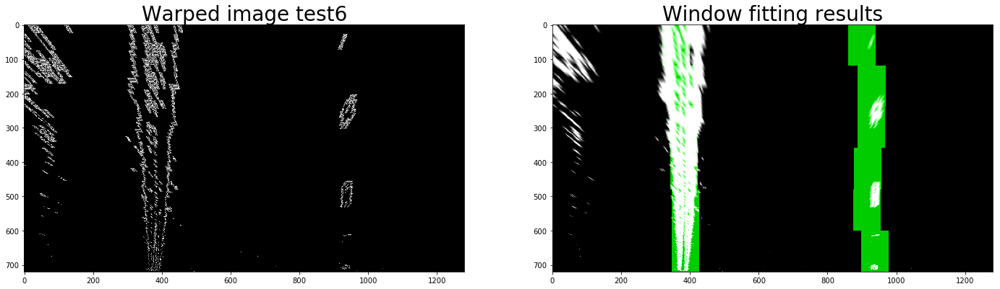

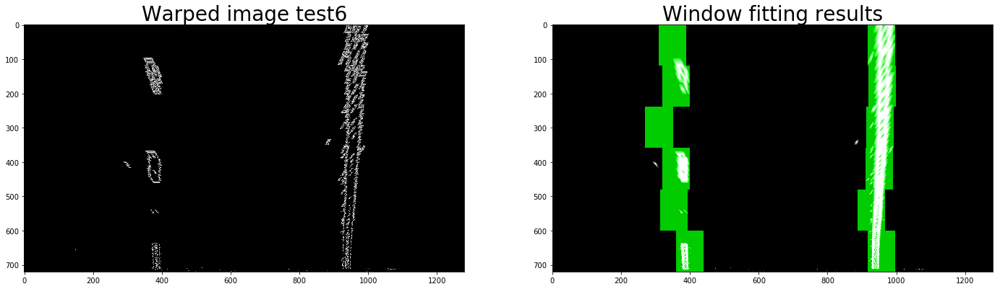

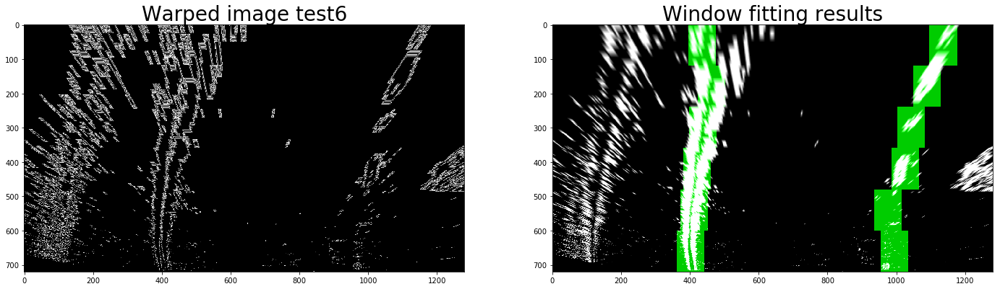

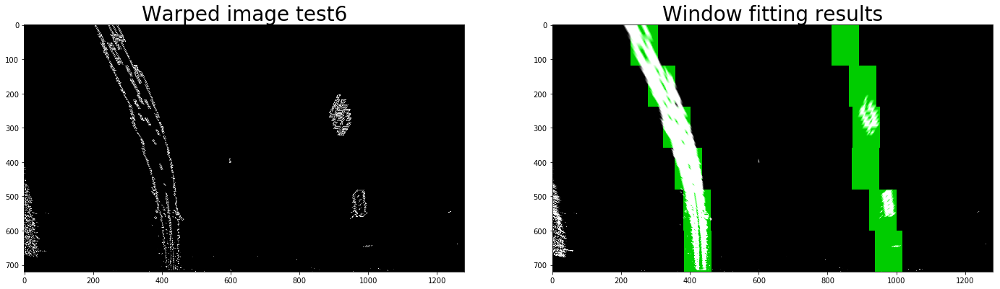

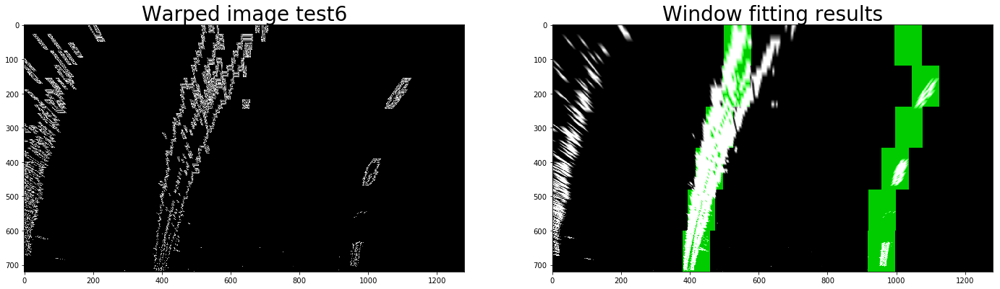

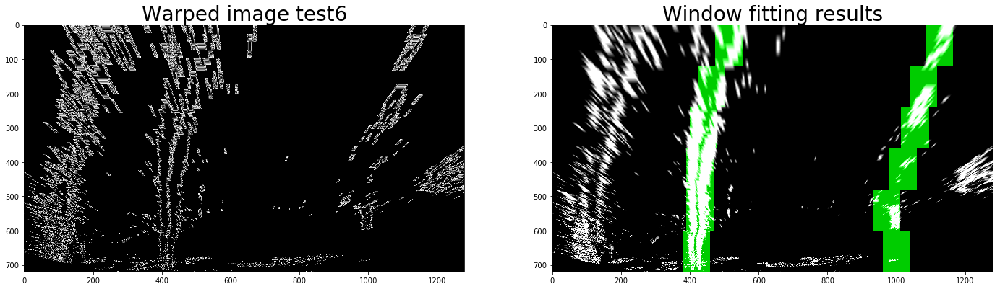

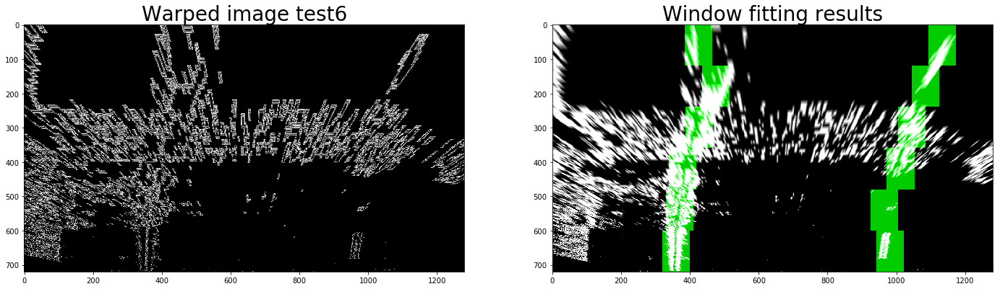

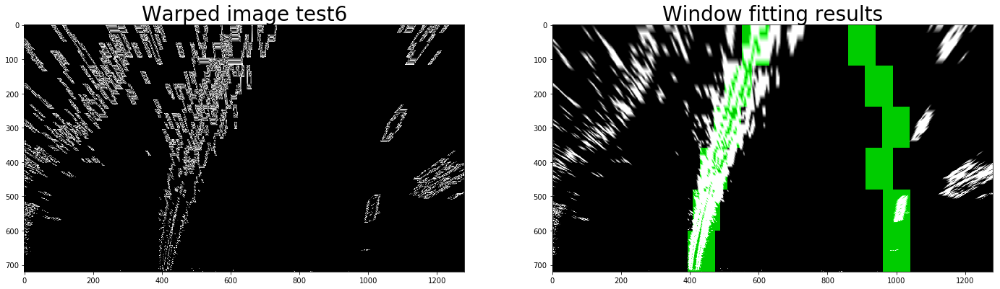

In [161]:
# Pipeline upto this points
def detect_lane_lines_from_image(image): 
    l_points, r_points = window_pipeline(image)
    
    left_y, left_x = np.where(l_points==255)
    left_lane = Line(allx = left_x, ally = left_y, unit='meter')
    left_lane.curverad()

    right_y, right_x = np.where(r_points==255)
    right_lane = Line(allx = right_x, ally = right_y, unit='meter')
    right_lane.curverad()

    return left_lane, right_lane

for image in road_images: 
    left_lane, right_lane = detect_lane_lines_from_image(image)

4192.72994314 1490.66817874
1321.94580679 m 489.59070338 m


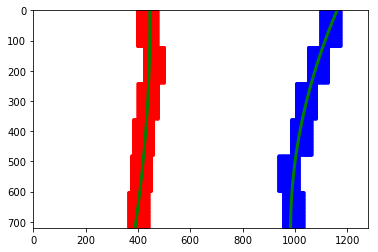

In [158]:
# Fit a second order polynomial to pixel positions in each fake lane line
left_fit = np.polyfit(left_y, left_x, 2)
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fit = np.polyfit(right_y, right_x, 2)
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Plot up the fake data
mark_size = 1
plt.plot(left_x, left_y, 'o', color='red', markersize=mark_size, alpha = 0.5)
plt.plot(right_x, right_y, 'o', color='blue', markersize=mark_size, alpha = 0.5)
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, ploty, color='green', linewidth=3)
plt.plot(right_fitx, ploty, color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images

y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)


# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(left_y*ym_per_pix, left_x*xm_per_pix, 2)
right_fit_cr = np.polyfit(right_y*ym_per_pix, right_x*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 632.1 m    626.2 m

<a id="lanearea">
# Lane Area
</a>

# Pipeline (video)

1. Provide a link to your final video output. Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).



# Discussion

1. Briefly discuss any problems / issues you faced in your implementation of this project. Where will your pipeline likely fail? What could you do to make it more robust?
